# 🐶 Using Transfer Learning and TensorFlow 2.0 to Classify Different Dog Breeds

In this project we're going to be using machine learning to help us identify different breeds of dogs.

To do this, we'll be using data from the [Kaggle dog breed identification competition](https://www.kaggle.com/c/dog-breed-identification/overview). It consists of a collection of 10,000+ labelled images of 120 different dog breeds.

Since the most important step in a deep learning problem is getting the data ready (turning it into numbers), that's what we're going to start with.

We're going to go through the following TensorFlow/Deep Learning workflow:
1. Get data ready (download from Kaggle, store, import).
2. Prepare the data (preprocessing, the 3 sets, X & y).
3. Choose and fit/train a model
4. Evaluating a model (making predictions, comparing them with the ground truth labels).
5. Improve the model through experimentation (start with 1000 images, make sure it works, increase the number of images).

The whole premise here is to get our data into Tensors (arrays of numbers which can be run on GPUs) and then allow a machine learning model to find patterns between them.

For our machine learning model, we're going to be using a pretrained deep learning model from TensorFlow Hub.

The process of using a pretrained model and adapting it to your own problem is called **transfer learning**. We do this because rather than train our own model from scratch (could be timely and expensive), we leverage the patterns of another model which has been trained to classify images.

## Getting our workspace ready


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
import tensorflow_hub as hub

In [ ]:
# Use the '-d' parameter as the destination for where the files should go
# !unzip "drive/MyDrive/data21/dog-breed-identification.zip" -d "drive/MyDrive/data21/"

Streaming output truncated to the last 5000 lines.
  inflating: drive/MyDrive/data21/train/83bc62b0fffa99a9c94ba0b67a5f7395.jpg  
  inflating: drive/MyDrive/data21/train/83bcff6b55ee179a7c123fa6103c377a.jpg  
  inflating: drive/MyDrive/data21/train/83be6d622ab74a5e7e08b53eb8fd566a.jpg  
  inflating: drive/MyDrive/data21/train/83c2d7419b0429b9fe953bc1b6cddbec.jpg  
  inflating: drive/MyDrive/data21/train/83cf7d7cd2a759a93e2ffd95bea9c6fb.jpg  
  inflating: drive/MyDrive/data21/train/83d405858f0931722ef21e8ac0adee4d.jpg  
  inflating: drive/MyDrive/data21/train/83d4125a4c3c7dc5956563276cb1cd74.jpg  
  inflating: drive/MyDrive/data21/train/83f0bb565b2186dbcc6a9d009cb26ff2.jpg  
  inflating: drive/MyDrive/data21/train/83fad0718581a696132c96c166472627.jpg  
  inflating: drive/MyDrive/data21/train/83fbbcc9a612e3f712b1ba199da61f20.jpg  
  inflating: drive/MyDrive/data21/train/8403d8936430c2f05ab7d74d23c2c0cb.jpg  
  inflating: drive/MyDrive/data21/train/8406d837b2d7fac1c3cd621abb4c4f9e.jpg  
 

In [ ]:
# Viewing our data
labels = pd.read_csv("drive/MyDrive/data21/labels.csv")
labels.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [ ]:
labels.describe()

,id,breed
count,10222,10222
unique,10222,120
top,fff43b07992508bc822f33d8ffd902ae,scottish_deerhound
freq,1,126


In [ ]:
labels.isna().sum()

,0
id,0
breed,0


<Axes: xlabel='breed'>

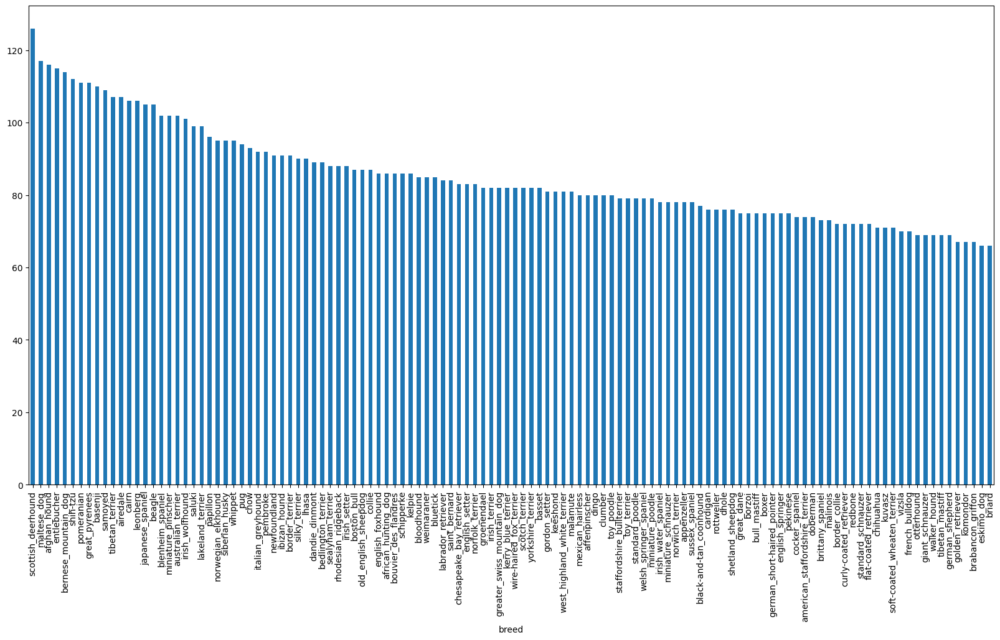

In [ ]:
labels["breed"].value_counts().plot(figsize=(20,10), kind = "bar")

In [ ]:
# Checking if every breed has enough images and the difference between the breed having highest images and the one with lowest
labels["breed"].value_counts().mean(), labels["breed"].value_counts().median()

(85.18333333333334, 82.0)

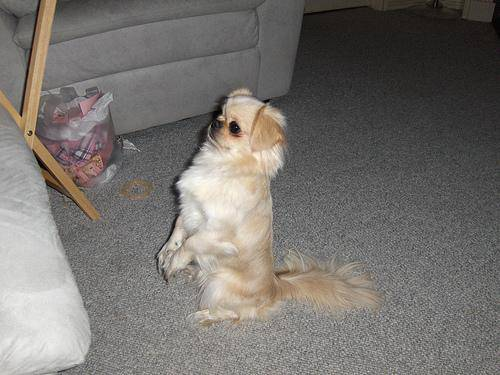

In [ ]:
# Viewing a photo
from IPython.display import Image
Image("drive/MyDrive/data21/train/001cdf01b096e06d78e9e5112d419397.jpg") # a pekinese

## Getting images
Since we've got the image ID's and their labels in a DataFrame (labels_csv), we'll use it to create:
+ A list a filepaths to training images
+ An array of all labels
+ An array of all unique labels

We will create a list of filepaths to images rather than importing them all to begin with. This is because working with filepaths(strings) is much more efficient than working with images

In [ ]:
# Create pathnames from images ID's
filenames = ["drive/MyDrive/data21/train/" + fname + ".jpg" for fname in labels["id"]]

filenames[:5]

['drive/MyDrive/data21/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/MyDrive/data21/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/MyDrive/data21/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/MyDrive/data21/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/MyDrive/data21/train/0021f9ceb3235effd7fcde7f7538ed62.jpg']

In [ ]:
len(filenames)

10222

In [ ]:
labels_name = labels["breed"].to_numpy() # convert labels column to NumPy array
labels_name[:10]

array(['boston_bull', 'dingo', 'pekinese', 'bluetick', 'golden_retriever',
       'bedlington_terrier', 'bedlington_terrier', 'borzoi', 'basenji',
       'scottish_deerhound'], dtype=object)

In [ ]:
# See if number of labels matches the number of filenames
if len(labels_name) == len(filenames):
  print("Number of labels matches number of filenames!")
else:
  print("Number of labels does not match number of filenames, check data directories.")

Number of labels matches number of filenames!


Creating the input data

We'll find all of the unique dog breed names.

Then we'll go through the list of labels_name and compare them to unique breeds and create a list of booleans indicating which one is the real label (True) and which ones aren't (False)

In [ ]:
# Find the unique label values
unique_breeds = np.unique(labels_name)
len(unique_breeds)

120

The length of unique_breeds should be 120, meaning we're working with images of 120 different breeds of dogs.

Now use unique_breeds to help turn our labels_name array into an array of booleans.

In [ ]:
# Example: Turn one label into an array of booleans
print(labels_name[0])
labels_name[0] == unique_breeds

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [ ]:
# Turn every label into a boolean array
boolean_labels = [label == np.array(unique_breeds) for label in labels_name]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

## Creating our own validation set
Since the dataset from Kaggle doesn't come with a validation set (a split of the data we can test our model on before making final predicitons on the test set), let's make one.

We could use Scikit-Learn's train_test_split function or we could simply make manual splits of the data.

For accessibility later, let's save our filenames variable to X (data) and our labels to y.


In [ ]:
# Setup X & y variables
X = filenames
y = boolean_labels

Since we're working with 10,000+ images, it's a good idea to work with a portion of them to make sure things are working before training on them all.

This is because computing with 10,000+ images could take a fairly long time. And our goal when working through machine learning projects is to reduce the time between experiments.

Let's start experimenting with 1000 and increase it as we need.

In [ ]:
# Set number of images to use for experimenting
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000, step:1000}
NUM_IMAGES

1000

In [ ]:
# Import train_test_split from Scikit-Learn
from sklearn.model_selection import train_test_split

# Split them into training and validation using NUM_IMAGES
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size=0.2,
                                                  random_state=42)

len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

In [ ]:
# Check out the training data (image file paths and labels)
X_train[:2], y_train[:2]

(['drive/MyDrive/data21/train/00bee065dcec471f26394855c5c2f3de.jpg',
  'drive/MyDrive/data21/train/0d2f9e12a2611d911d91a339074c8154.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, Fals

## Preprocessing images (turning images into Tensors)
Our labels are in numeric format but our images are still just file paths.

Since we're using TensorFlow, our data has to be in the form of Tensors.

To preprocess our images into Tensors we're going to write a function which does a few things:

+ Takes an image filename as input.
+ Uses TensorFlow to read the file and save it to a variable, image.
+ Turn our image (a jpeg file) into Tensors.
+ Resize the image to be of shape (224, 224).
+ Return the modified image.
+ A good place to read about this type of function is the TensorFlow documentation on loading images.

We are using (224, 224), which is (heigh, width). It's because this is the size of input our model takes, an image which is (224, 224, 3).

In [ ]:
# Define image size
IMG_SIZE = 224

def process_image(image_path):
  """
  Takes an image file path and turns it into a Tensor.
  """
  # Read in image file
  image = tf.io.read_file(image_path)
  # Turn the jpeg image into numerical Tensor with 3 colour channels (Red, Green, Blue)
  image = tf.image.decode_jpeg(image, channels=3)
  # Convert the colour channel values from 0-225 values to 0-1 values
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to our desired size (224, 244)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])
  return image

## Creating data batches
Now we've got a function to convert our images into Tensors, we'll now build one to turn our data into batches.

In [ ]:
# Create a simple function to return a tuple (image, label)
def get_image_label(image_path, label):
  """
  Takes an image file path name and the associated label,
  processes the image and returns a tuple of (image, label).
  """
  image = process_image(image_path)
  return image, label

In [ ]:
# Define the batch size, 32 is a good default
BATCH_SIZE = 32

# Create a function to turn data into batches
def create_data_batches(x, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Creates batches of data out of image (x) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle it if it's validation data.
  Also accepts test data as input (no labels).
  """
  # If the data is a test dataset, we probably don't have labels
  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x))) # only filepaths
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

  # If the data if a valid dataset, we don't need to shuffle it
  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                               tf.constant(y))) # labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    # If the data is a training dataset, we shuffle it
    print("Creating training data batches...")
    # Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                              tf.constant(y))) # labels

    # Shuffling pathnames and labels before mapping image processor function is faster than shuffling images
    data = data.shuffle(buffer_size=len(x))

    # Create (image, label) tuples (this also turns the image path into a preprocessed image)
    data = data.map(get_image_label)

    # Turn the data into batches
    data_batch = data.batch(BATCH_SIZE)
  return data_batch

In [ ]:
# Create training and validation data batches
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...


In [ ]:
# Check out the different attributes of our data batches
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

## Visualizing Data Batches


In [ ]:
import matplotlib.pyplot as plt

# Create a function for viewing images in a data batch
def show_25_images(images, labels):
  """
  Displays 25 images from a data batch.
  """
  # Setup the figure
  plt.figure(figsize=(12, 12))
  # Loop through 25 (for displaying 25 images)
  for i in range(25):
    ax = plt.subplot(5, 5, i+1)
    # Display an image
    plt.imshow(images[i])
    # Add the image label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    plt.axis("off")

To make computation efficient, a batch is a tighly wound collection of Tensors.

So to view data in a batch, we've got to unwind it.

We can do so by calling the [`as_numpy_iterator()`](https://www.tensorflow.org/api_docs/python/tf/data/Dataset#as_numpy_iterator) method on a data batch.

This will turn our a data batch into something which can be iterated over.

Passing an iterable to [`next()`](https://docs.python.org/3/library/functions.html#next) will return the next item in the iterator.

In our case, next will return a batch of 32 images and label pairs.


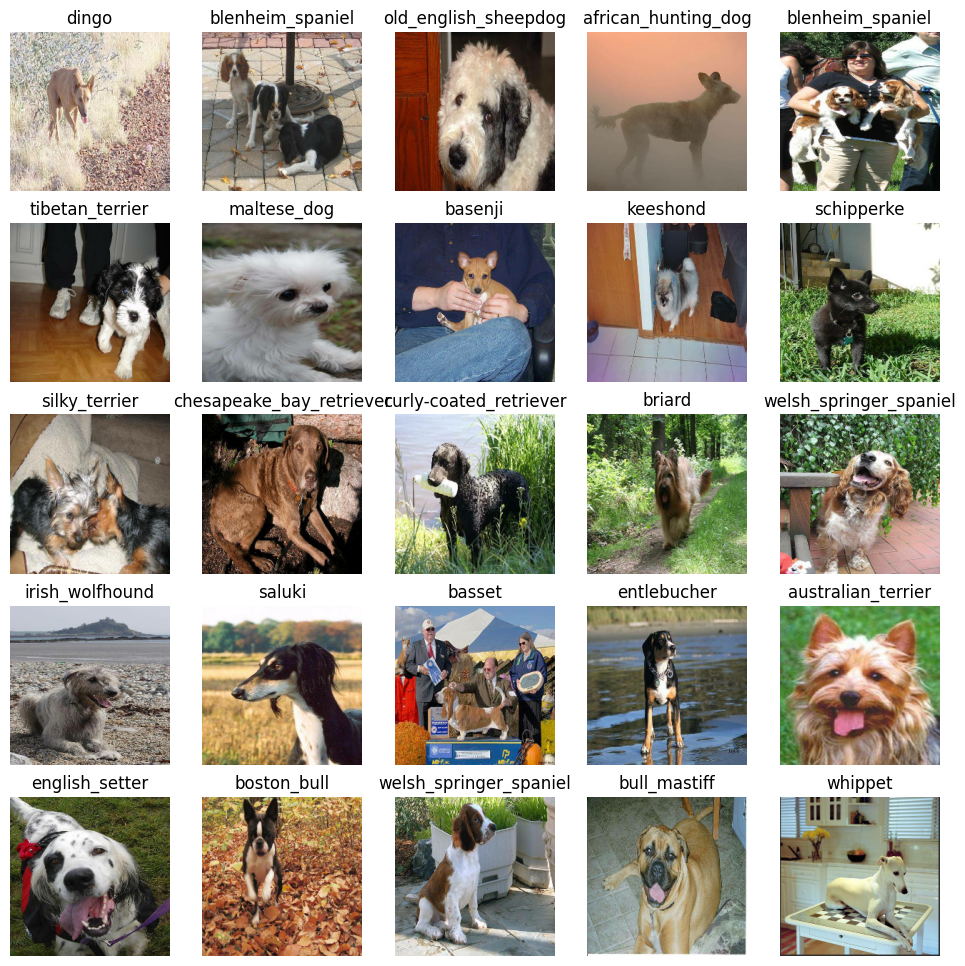

In [ ]:
# Visualize training images from the training data batch
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

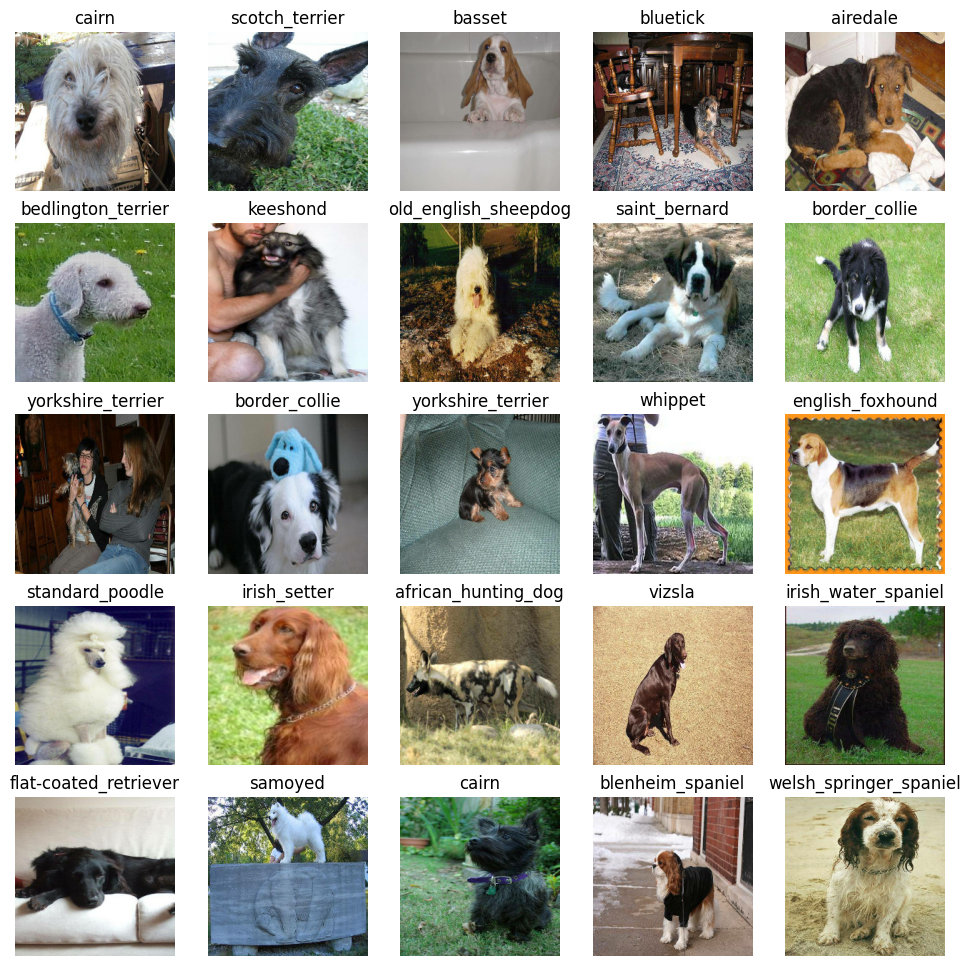

In [ ]:
# Visualize validation images from the validation data batch
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

# Creating and training a model

Now our data is ready, let's prepare it modelling. We'll use an existing model from [TensorFlow Hub](https://tfhub.dev/).

Using a pretrained machine learning model is often referred to as **transfer learning**.

#### We are using a pretrained model because

Building a machine learning model and training it on lots from scratch can be expensive and time consuming.

Transfer learning helps eleviate some of these by taking what another model has learned and using that information with our own problem.

We are going to use mobilenet_v2

SSD-based object detection model trained on Open Images V4 with ImageNet pre-trained MobileNet V2 as image feature extractor.

https://www.kaggle.com/models/google/mobilenet-v2/TensorFlow2/130-224-classification/2

### Building a model

Before we build a model, there are a few things we need to define:
* The input shape (images, in the form of Tensors) to our model.
* The output shape (image labels, in the form of Tensors) of our model.
* The URL of the model we want to use.

In [ ]:
# Setup input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, colour channels

# Setup output shape of the model
OUTPUT_SHAPE = len(unique_breeds) # number of unique labels

# Setup model URL from TensorFlow Hub
MODEL_URL = "https://www.kaggle.com/models/google/mobilenet-v2/TensorFlow2/130-224-classification/2"

In [ ]:
import tf_keras as keras
def create_model(input=INPUT_SHAPE, output=OUTPUT_SHAPE, url=MODEL_URL):
  print("Building model with:", MODEL_URL)

  model = keras.Sequential([
    hub.KerasLayer(MODEL_URL),
    keras.layers.Dense(units=OUTPUT_SHAPE,
                          activation="softmax")
  ])

  model.compile(
      loss=keras.losses.CategoricalCrossentropy(),
      optimizer=keras.optimizers.Adam(),
      metrics=["accuracy"]
  )

  # Build the model
  model.build(INPUT_SHAPE)

  return model

In [ ]:
# Create a model
model = create_model()
model.summary()

Building model with: https://www.kaggle.com/models/google/mobilenet-v2/TensorFlow2/130-224-classification/2
Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_4 (KerasLayer)  (None, 1001)              5432713   
                                                                 
 dense_4 (Dense)             (None, 120)               120240    
                                                                 
Total params: 5552953 (21.18 MB)
Trainable params: 120240 (469.69 KB)
Non-trainable params: 5432713 (20.72 MB)
_________________________________________________________________


### Creating callbacks

We've got a model ready to go but before we train it we'll make some callbacks.

Callbacks are helper functions a model can use during training to do things such as save a models progress, check a models progress or stop training early if a model stops improving.

The two callbacks we're going to add are a TensorBoard callback and an Early Stopping callback.

#### TensorBoard Callback

[TensorBoard](https://www.tensorflow.org/tensorboard/get_started) helps provide a visual way to monitor the progress of your model during and after training.

We can use it to track the performance measures of a model such as loss and accuracy.

To set up a TensorBoard callback and view TensorBoard in a notebook, we need to do three things:
1. Load the TensorBoard notebook extension.
2. Create a TensorBoard callback which is able to save logs to a directory and pass it to our model's `fit()` function.
3. Visualize the our models training logs using the `%tensorboard` magic function (we'll do this later on).

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
import datetime
import os
# Create a function to build a TensorBoard callback
def create_tensorboard_callback():
  # Create a log directory for storing TensorBoard logs
  logdir = os.path.join("drive/My Drive/data21/logs",
                        # Make it so the logs get tracked whenever we run an experiment
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return keras.callbacks.TensorBoard(logdir)

#### Early Stopping Callback

[Early stopping](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping) helps prevent overfitting by stopping a model when a certain evaluation metric stops improving. If a model trains for too long, it can do so well at finding patterns in a certain dataset that it's not able to use those patterns on another dataset it hasn't seen before (doesn't generalize).



In [ ]:
# Create early stopping (once our model stops improving, stop training)
early_stopping = keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=3) # stops after 3 rounds of no improvements

### Training a model (on a subset of data)
Our first model is only going to be trained on 1000 images. Or trained on 800 images and then validated on 200 images, meaning 1000 images total or about 10% of the total data.

We do this to make sure everything is working. And if it is, we can step it up later and train on the entire training dataset.

The final parameter we'll define before training is `NUM_EPOCHS` (also known as **number of epochs**).

`NUM_EPOCHS` defines how many passes of the data we'd like our model to do. A pass is equivalent to our model trying to find patterns in each dog image and see which patterns relate to each label.

If `NUM_EPOCHS=1`, the model will only look at the data once and will probably score badly because it hasn't a chance to correct itself.

What's a good value for `NUM_EPOCHS`?

This one is hard to say. 10 could be a good start but so could 100. This is one of the reasons we created an early stopping callback. Having early stopping setup means if we set `NUM_EPOCHS` to 100 but our model stops improving after 22 epochs, it'll stop training.


In [ ]:
# How many rounds should we get the model to look through the data?
NUM_EPOCHS = 100 #@param {type:"slider", min:10, max:100, step:10}

We have got everything ready now

Lets create a function to train our model

In [ ]:
def train_model():
  """
  Trains a given model and returns the trained version.
  """
  model = create_model()

  tensorboard = create_tensorboard_callback()

  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1, # check validation metrics every epoch
            callbacks=[tensorboard, early_stopping])

  return model

In [ ]:
model = train_model()

Building model with: https://www.kaggle.com/models/google/mobilenet-v2/TensorFlow2/130-224-classification/2
Epoch 1/100
25/25 [==============================] - 10s 238ms/step - loss: 4.4375 - accuracy: 0.1300 - val_loss: 3.3205 - val_accuracy: 0.3150
Epoch 2/100
25/25 [==============================] - 6s 223ms/step - loss: 1.5816 - accuracy: 0.6950 - val_loss: 2.1302 - val_accuracy: 0.5000
Epoch 3/100
25/25 [==============================] - 4s 154ms/step - loss: 0.5553 - accuracy: 0.9400 - val_loss: 1.6585 - val_accuracy: 0.6150
Epoch 4/100
25/25 [==============================] - 4s 176ms/step - loss: 0.2511 - accuracy: 0.9875 - val_loss: 1.4872 - val_accuracy: 0.6500
Epoch 5/100
25/25 [==============================] - 6s 228ms/step - loss: 0.1466 - accuracy: 0.9975 - val_loss: 1.4137 - val_accuracy: 0.6500
Epoch 6/100
25/25 [==============================] - 4s 155ms/step - loss: 0.0985 - accuracy: 1.0000 - val_loss: 1.3629 - val_accuracy: 0.6600
Epoch 7/100
25/25 [==============

In [ ]:
%tensorboard --logdir drive/MyDrive/data21/logs

Reusing TensorBoard on port 6007 (pid 15326), started 0:44:57 ago. (Use '!kill 15326' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
# Predicting on validation data using our trained model
predictions = model.predict(val_data, verbose = 1)
predictions

7/7 [==============================] - 35s 173ms/step


array([[7.7743237e-03, 1.7626620e-04, 1.3065898e-03, ..., 1.4173812e-03,
        1.9226096e-05, 2.6555655e-03],
       [2.3873933e-03, 3.3762716e-04, 5.4024449e-03, ..., 2.5810994e-04,
        9.5503242e-04, 3.3825403e-04],
       [6.1301753e-06, 4.3711669e-05, 9.4675570e-06, ..., 3.6929626e-04,
        1.0141628e-04, 2.0201143e-04],
       ...,
       [2.8770751e-07, 1.1761544e-04, 2.4823117e-05, ..., 2.1612654e-05,
        1.2148409e-04, 8.2039733e-06],
       [2.6776204e-03, 3.6276449e-04, 1.7556286e-04, ..., 2.2937624e-04,
        2.5049017e-05, 3.7077058e-03],
       [6.3027913e-04, 5.8375867e-06, 6.0681882e-03, ..., 2.2204081e-03,
        3.6100720e-04, 1.4129549e-04]], dtype=float32)

In [ ]:
len(predictions), len(predictions[0])

(200, 120)

In [ ]:
print(predictions[0])
print(f"Maximum probability : {np.max(predictions[0])}")
print(f"Index of maximum probability : {np.argmax(predictions[0])}")
print(f"Predicted label : {unique_breeds[np.argmax(predictions[0])]}")

[7.77432369e-03 1.76266200e-04 1.30658981e-03 9.26814566e-04
 7.25335209e-04 6.00970016e-05 8.63299221e-02 2.58034590e-04
 1.26394280e-03 8.25866999e-04 1.09899428e-03 8.59923384e-05
 7.40372983e-04 1.47910730e-04 1.09925319e-03 2.32007325e-04
 1.34356756e-04 1.32297844e-01 1.42679943e-04 4.15066679e-05
 2.50120618e-04 5.16691420e-04 7.37862501e-05 5.91266435e-04
 1.23637737e-05 4.16753814e-04 1.50051206e-01 5.63678877e-05
 4.27518011e-04 1.47503844e-04 1.01797646e-04 1.73012516e-03
 3.58706369e-04 9.23335483e-06 2.57639069e-04 2.90199034e-02
 1.66697209e-05 1.41264929e-03 3.54806893e-04 3.28058086e-04
 4.39991057e-03 5.22341679e-06 5.07761906e-05 3.79446748e-04
 3.45850021e-05 2.21832874e-04 6.72555252e-05 1.54583948e-04
 4.98569105e-04 2.56292085e-04 5.57775318e-04 1.39646843e-04
 8.23227238e-05 2.09313497e-04 8.29538621e-05 1.31489733e-05
 4.15694230e-04 7.46112457e-03 1.86943531e-03 1.93163738e-01
 1.18665739e-04 3.50291375e-05 1.10163540e-03 1.44137766e-05
 1.54556031e-03 1.344327

In [ ]:
# Creating a function to retrieve predicted label
def get_pred_label(predictions_prob):
  return unique_breeds[np.argmax(predictions_prob)]

## Visualizing our predictions
We are going to create a function on which we are going to find the truth label and predicted label and check if they are correct or not while displaying the image as well

We will have to unbatchify our data first

In [ ]:
# Create a function to unbatch a batched dataset
def unbatchify(data):
  """
  Takes a batched dataset of (image, label) Tensors and returns separate arrays
  of images and labels.
  """
  images = []
  labels = []
  # Loop through unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels

# Unbatchify the validation data
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.27701408, 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

In [ ]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth label and image for sample n.
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  # Get the pred label
  pred_label = get_pred_label(pred_prob)

  # Plot image & remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the color of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                      np.max(pred_prob)*100,
                                      true_label),
                                      color=color)

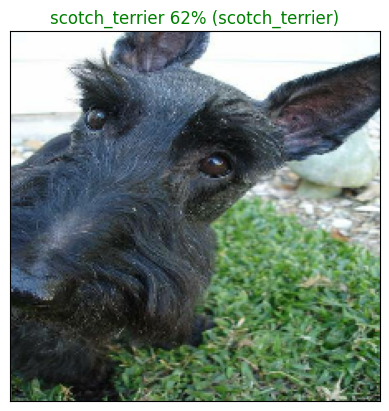

In [ ]:
# View an example prediction, original image and truth label
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images)

## Saving and reloading a model

After training a model, it's a good idea to save it. Saving it means you can share it with colleagues, put it in an application and more importantly, won't have to go through the potentially expensive step of retraining it.

The format of an entire saved Keras model is h5. So we'll make a function which can take a model as input and utilise the save() method to save it as a h5 file to a specified directory.

In [ ]:
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (str)
  for clarity and reuse.
  """
  # Create model directory with current time
  modeldir = os.path.join("drive/MyDrive/data21/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [ ]:
# Function for loading a model
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [ ]:
# Save our model trained on 1000 images
save_model(model, suffix="1000-images")

Saving model to: drive/MyDrive/Data/models/20250101-03481735703306-1000-images.h5...


/usr/local/lib/python3.10/dist-packages/tf_keras/src/engine/training.py:3098: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native TF-Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


'drive/MyDrive/Data/models/20250101-03481735703306-1000-images.h5'

In [ ]:
# Load our model trained on 1000 images
model_1000_images = load_model('drive/MyDrive/Data/models/20241231-04511735620698-1000-images.h5')

Loading saved model from: drive/MyDrive/Data/models/20241231-04511735620698-1000-images.h5


In [ ]:
# Evaluate the pre-saved model
model.evaluate(val_data)

7/7 [==============================] - 1s 107ms/step - loss: 1.2871 - accuracy: 0.6600


[1.2871043682098389, 0.6600000262260437]

In [ ]:
# Evaluate the loaded model
model_1000_images.evaluate(val_data)

7/7 [==============================] - 1s 101ms/step - loss: 1.2363 - accuracy: 0.6800


[1.2362502813339233, 0.6800000071525574]

## Training a model (on the full data)
Now we know our model works on a subset of the data, we can start to move forward with training one on the full data.

Above, we saved all of the training filepaths to X and all of the training labels to y. Let's check them out.

In [ ]:
# Remind ourselves of the size of the full dataset
len(X), len(y)

(10222, 10222)

In [ ]:
# Turn full training data in a data batch
full_data = create_data_batches(X, y)

Creating training data batches...


In [ ]:
# Instantiate a new model for training on the full dataset
full_model = create_model()

Building model with: https://www.kaggle.com/models/google/mobilenet-v2/TensorFlow2/130-224-classification/2


In [ ]:
# Create full model callbacks

# TensorBoard callback
full_model_tensorboard = create_tensorboard_callback()

# Early stopping callback
# Note: No validation set when training on all the data, therefore can't monitor validation accruacy
full_model_early_stopping = keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

In [ ]:
%tensorboard --logdir drive/MyDrive/data21/logs

<IPython.core.display.Javascript object>

In [ ]:
# Fit the full model to the full training data
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard,
                          full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 54s 143ms/step - loss: 1.3349 - accuracy: 0.6730
Epoch 2/100
320/320 [==============================] - 45s 142ms/step - loss: 0.3977 - accuracy: 0.8833
Epoch 3/100
320/320 [==============================] - 47s 146ms/step - loss: 0.2361 - accuracy: 0.9386
Epoch 4/100
320/320 [==============================] - 46s 144ms/step - loss: 0.1524 - accuracy: 0.9617
Epoch 5/100
320/320 [==============================] - 48s 149ms/step - loss: 0.1064 - accuracy: 0.9788
Epoch 6/100
320/320 [==============================] - 47s 148ms/step - loss: 0.0765 - accuracy: 0.9870
Epoch 7/100
320/320 [==============================] - 47s 146ms/step - loss: 0.0572 - accuracy: 0.9916
Epoch 8/100
320/320 [==============================] - 45s 141ms/step - loss: 0.0465 - accuracy: 0.9941
Epoch 9/100
320/320 [==============================] - 46s 143ms/step - loss: 0.0367 - accuracy: 0.9960
Epoch 10/100
320/320 [==============================] - 46s 142m

In [ ]:
# Save model to file
save_model(full_model, suffix="all-images")

Saving model to: drive/MyDrive/data21/models/20250101-07171735715838-all-images.h5...


/usr/local/lib/python3.10/dist-packages/tf_keras/src/engine/training.py:3098: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native TF-Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


'drive/MyDrive/data21/models/20250101-07171735715838-all-images.h5'

In [ ]:
# Load in the full model
loaded_full_model = load_model('drive/MyDrive/data21/models/20250101-07171735715838-all-images.h5')

Loading saved model from: drive/MyDrive/data21/models/20250101-07171735715838-all-images.h5


### Making predictions on the test dataset

Since our model has been trained on images in the form of Tensor batches, to make predictions on the test data, we'll have to get it into the same format.

Luckily we created `create_data_batches()` earlier which can take a list of filenames as input and convert them into Tensor batches.

To make predictions on the test data, we'll:
* Get the test image filenames.
* Convert the filenames into test data batches using `create_data_batches()` and setting the `test_data` parameter to `True` (since there are no labels with the test images).
* Make a predictions array by passing the test data batches to the `predict()` function.

In [ ]:
# Load test image filenames (since we're using os.listdir(), these already have .jpg)
test_path = "drive/MyDrive/data21/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]

test_filenames[:10]

['drive/MyDrive/data21/test/000621fb3cbb32d8935728e48679680e.jpg',
 'drive/MyDrive/data21/test/00102ee9d8eb90812350685311fe5890.jpg',
 'drive/MyDrive/data21/test/0012a730dfa437f5f3613fb75efcd4ce.jpg',
 'drive/MyDrive/data21/test/001510bc8570bbeee98c8d80c8a95ec1.jpg',
 'drive/MyDrive/data21/test/001a5f3114548acdefa3d4da05474c2e.jpg',
 'drive/MyDrive/data21/test/00225dcd3e4d2410dd53239f95c0352f.jpg',
 'drive/MyDrive/data21/test/002c2a3117c2193b4d26400ce431eebd.jpg',
 'drive/MyDrive/data21/test/002c58d413a521ae8d1a5daeb35fc803.jpg',
 'drive/MyDrive/data21/test/002f80396f1e3db687c5932d7978b196.jpg',
 'drive/MyDrive/data21/test/0036c6bcec6031be9e62a257b1c3c442.jpg']

In [ ]:
# How many test images are there?
len(test_filenames)

10357

In [ ]:
# Create test data batch
test_data = create_data_batches(test_filenames, test_data=True)

Creating test data batches...


In [ ]:
# Make predictions on test data batch using the loaded full model
test_predictions = loaded_full_model.predict(test_data,
                                             verbose=1)

324/324 [==============================] - 156s 482ms/step


In [ ]:
# Check out the test predictions
test_predictions[:10]

array([[2.8407131e-12, 4.8846188e-12, 3.4342764e-15, ..., 8.9752045e-14,
        1.7946886e-10, 2.7832476e-11],
       [2.5167017e-06, 6.7772930e-07, 6.9846536e-08, ..., 1.4232589e-10,
        1.5624940e-07, 1.7171129e-09],
       [1.2978364e-10, 1.5601496e-06, 2.9976398e-08, ..., 6.7520209e-06,
        1.8451367e-09, 4.9907856e-11],
       ...,
       [8.1409821e-09, 1.5658952e-10, 2.9776231e-10, ..., 6.9165750e-12,
        1.3867499e-11, 2.2406979e-10],
       [4.0934672e-11, 5.5871002e-10, 2.7086644e-10, ..., 1.9312979e-06,
        9.9174917e-09, 2.2816363e-11],
       [2.9694256e-08, 6.8016759e-11, 2.4122729e-10, ..., 6.0290067e-12,
        1.3382953e-11, 2.2494329e-07]], dtype=float32)